In [1]:
import scipy.io
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
from PIL import Image

df = pd.read_csv('./Dataset/umist_faces.csv')


unique_labels = df['label'].unique()

image_height, image_width = 112, 92

plt.figure(figsize=(15, 10))
for i, label in enumerate(unique_labels):
    person_image = df[df['label'] == label].iloc[0, 1:].values.astype(float).reshape(image_height, image_width)
    
    plt.subplot(4, 6, i + 1)
    plt.imshow(person_image, cmap='gray')
    plt.axis('off')
    plt.title(f"Person {label}")

plt.suptitle("Unique Images of Individuals from the UMIST Dataset")
plt.tight_layout()
plt.show()

FileNotFoundError: [Errno 2] No such file or directory: '../Dataset/umist_faces.csv'

In [ ]:
duplicates = df.duplicated()
num_duplicates = duplicates.sum()

duplicates = df[duplicates]


if not duplicates.empty:
    print(f"Found {len(duplicates)} duplicate rows:")
    print(duplicates)
else:
    print("No duplicate rows found in the DataFrame.")

Found 10 duplicate rows:
   label  pixel_0  pixel_1  pixel_2  pixel_3  pixel_4  pixel_5  pixel_6  \
63    1b    230.0    230.0    232.0    230.0    233.0    232.0    232.0   
64    1b    233.0    232.0    233.0    232.0    233.0    234.0    230.0   
65    1b    234.0    233.0    234.0    234.0    234.0    233.0    234.0   
66    1b    233.0    233.0    234.0    233.0    233.0    234.0    234.0   
67    1b    234.0    233.0    234.0    234.0    234.0    233.0    234.0   
68    1b    234.0    233.0    234.0    234.0    234.0    234.0    234.0   
69    1b    234.0    234.0    233.0    234.0    233.0    234.0    233.0   
70    1b    234.0    234.0    234.0    234.0    234.0    234.0    234.0   
71    1b    234.0    234.0    234.0    234.0    234.0    234.0    232.0   
72    1b    221.0    209.0    140.0     86.0     83.0     74.0     66.0   

    pixel_7  pixel_8  ...  pixel_10294  pixel_10295  pixel_10296  pixel_10297  \
63    232.0    229.0  ...        113.0        122.0        127.0    

In [ ]:
if num_duplicates > 0:
    df = df.drop_duplicates()
    print(f"Duplicates removed. New dataset shape: {df.shape}")
else:
    print("No duplicates found in the dataset.")

Duplicates removed. New dataset shape: (565, 10305)


In [ ]:
missing_values = df.isnull().sum().sum()
if missing_values > 0:
    print(f"Dataset contains {missing_values} missing values. Cleaning is required.")
    df = df.dropna()
else:
    print("No missing values found in the dataset.")

No missing values found in the dataset.


Label distribution:
 label
1s    48
1a    38
1l    34
1k    34
1t    34
1r    33
1j    32
1n    30
1e    26
1m    26
1p    26
1q    26
1c    26
1b    25
1d    24
1f    23
1h    22
1i    20
1g    19
1o    19
Name: count, dtype: int64


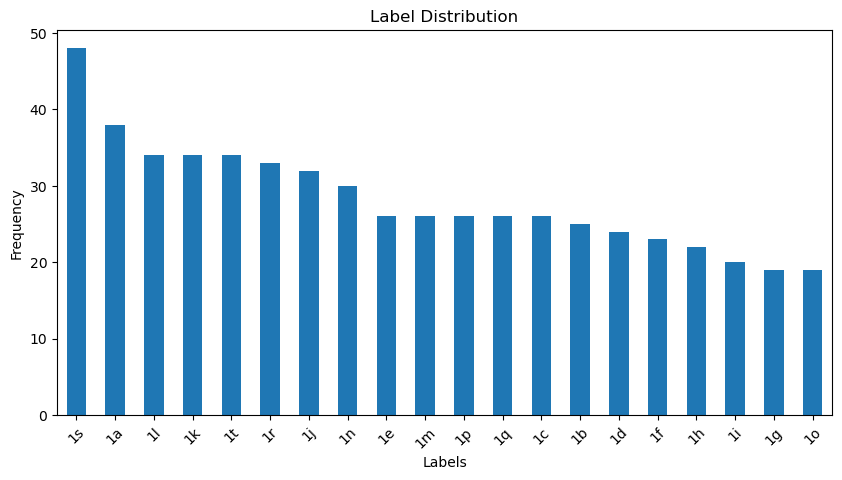

In [ ]:
# Check for label distribution
label_counts = df['label'].value_counts()
print("Label distribution:\n", label_counts)

# Plot the distribution
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 5))
label_counts.plot(kind='bar')
plt.title("Label Distribution")
plt.xlabel("Labels")
plt.ylabel("Frequency")
plt.xticks(rotation=45)
plt.show()


Balanced dataset shape: (960, 112, 92, 1)
Label distribution after augmentation: (array(['1a', '1b', '1c', '1d', '1e', '1f', '1g', '1h', '1i', '1j', '1k',
       '1l', '1m', '1n', '1o', '1p', '1q', '1r', '1s', '1t'], dtype='<U2'), array([48, 48, 48, 48, 48, 48, 48, 48, 48, 48, 48, 48, 48, 48, 48, 48, 48,
       48, 48, 48], dtype=int64))


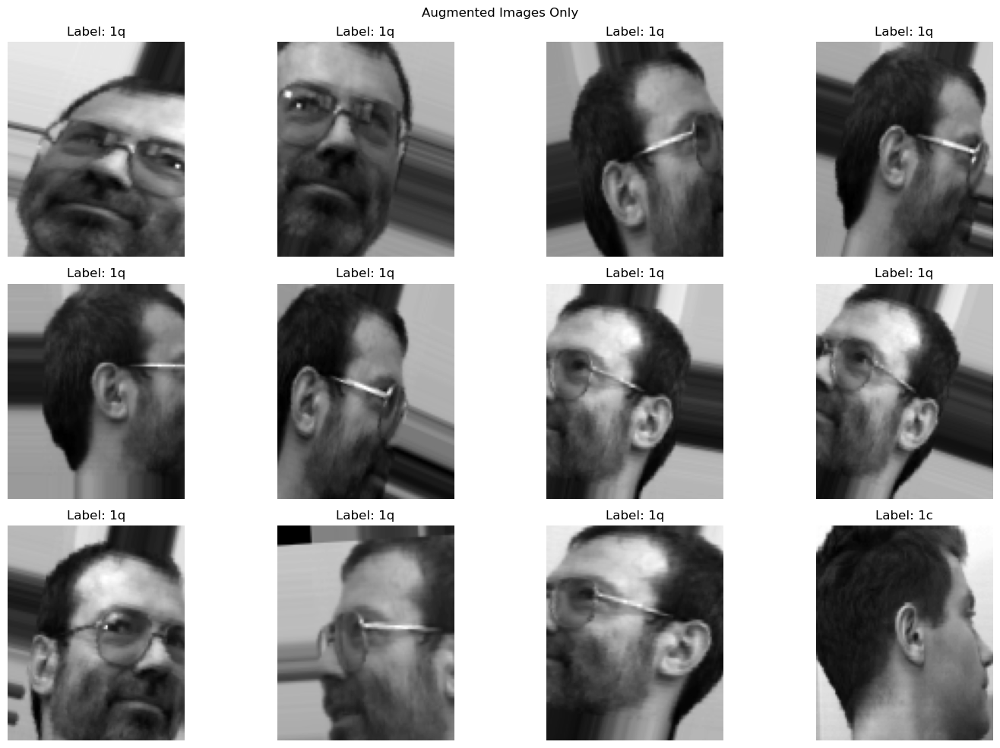

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import numpy as np
import matplotlib.pyplot as plt

# Data augmentation generator setup
datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Convert the dataset into a format suitable for augmentation
image_height, image_width = 112, 92
X = df.iloc[:, 1:].values.reshape(-1, image_height, image_width, 1).astype(float)  # Shape to (samples, height, width, channels)
y = df['label'].values

# Determine maximum class count
label_counts = df['label'].value_counts()
max_count = label_counts.max()

# Augment and balance dataset
balanced_images = []
balanced_labels = []

for label in label_counts.index:
    class_images = X[y == label]  # Select images for the current class
    class_labels = y[y == label]  # Select labels for the current class
    
    # Add existing images
    balanced_images.extend(class_images)  # Add existing images
    balanced_labels.extend(class_labels)  # Add corresponding labels
    
    # Augment images for minority classes
    if len(class_images) < max_count:
        total_needed = max_count - len(class_images)
        
        # Generate augmented images
        for i, batch in enumerate(datagen.flow(class_images, batch_size=1)):
            balanced_images.append(batch[0])  # Add augmented image
            balanced_labels.append(label)  # Add corresponding label
            if i + 1 >= total_needed:  # Stop when enough samples are generated
                break

balanced_images = np.array(balanced_images)
balanced_labels = np.array(balanced_labels)

print("Balanced dataset shape:", balanced_images.shape)
print("Label distribution after augmentation:", np.unique(balanced_labels, return_counts=True))

augmented_start_index = len(X)  
plt.figure(figsize=(15, 10))
for i in range(12):
    plt.subplot(3, 4, i + 1)
    plt.imshow(balanced_images[augmented_start_index + i].reshape(image_height, image_width), cmap='gray')
    plt.axis('off')
    plt.title(f"Label: {balanced_labels[augmented_start_index + i]}")
plt.suptitle("Augmented Images Only")
plt.tight_layout()
plt.show()


In [ ]:
from sklearn.model_selection import train_test_split

# Normalize images (if not already done)
balanced_images = balanced_images.astype(np.float32) / 255.0

# Perform train-test-validation split
X_train, X_temp, y_train, y_temp = train_test_split(
    balanced_images, balanced_labels, test_size=0.4, stratify=balanced_labels, random_state=42
)
X_val, X_test, y_val, y_test = train_test_split(
    X_temp, y_temp, test_size=0.5, stratify=y_temp, random_state=42
)

# Verify the splits
print(f"Training set: {X_train.shape}, {y_train.shape}")
print(f"Validation set: {X_val.shape}, {y_val.shape}")
print(f"Testing set: {X_test.shape}, {y_test.shape}")


Training set: (576, 112, 92, 1), (576,)
Validation set: (192, 112, 92, 1), (192,)
Testing set: (192, 112, 92, 1), (192,)


In [ ]:
def label_distribution(labels, set_name):
    unique, counts = np.unique(labels, return_counts=True)
    print(f"{set_name} label distribution: {dict(zip(unique, counts))}")

# Check label distributions for train, validation, and test sets
label_distribution(y_train, "Train")
label_distribution(y_val, "Validation")
label_distribution(y_test, "Test")


Train label distribution: {'1a': 29, '1b': 29, '1c': 29, '1d': 29, '1e': 29, '1f': 29, '1g': 28, '1h': 28, '1i': 29, '1j': 29, '1k': 28, '1l': 29, '1m': 29, '1n': 29, '1o': 28, '1p': 29, '1q': 29, '1r': 29, '1s': 29, '1t': 29}
Validation label distribution: {'1a': 10, '1b': 10, '1c': 9, '1d': 9, '1e': 9, '1f': 10, '1g': 10, '1h': 10, '1i': 9, '1j': 9, '1k': 10, '1l': 10, '1m': 10, '1n': 9, '1o': 10, '1p': 10, '1q': 9, '1r': 10, '1s': 10, '1t': 9}
Test label distribution: {'1a': 9, '1b': 9, '1c': 10, '1d': 10, '1e': 10, '1f': 9, '1g': 10, '1h': 10, '1i': 10, '1j': 10, '1k': 10, '1l': 9, '1m': 9, '1n': 10, '1o': 10, '1p': 9, '1q': 10, '1r': 9, '1s': 9, '1t': 10}


In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, models

def create_cnn_model(input_shape=(112, 92, 1), embedding_dim=400):
    model = models.Sequential([
        layers.Input(shape=input_shape),
        layers.Conv2D(32, kernel_size=3, activation='relu', padding='same'),
        layers.MaxPooling2D(pool_size=2),
        layers.Conv2D(64, kernel_size=3, activation='relu', padding='same'),
        layers.MaxPooling2D(pool_size=2),
        layers.Conv2D(128, kernel_size=3, activation='relu', padding='same'),
        layers.MaxPooling2D(pool_size=2),
        layers.Flatten(),
        layers.Dense(256, activation='relu'),
        # layers.Dense(embedding_dim, activation=None)
    ])
    return model


In [ ]:
embedding_dim = 400 
input_shape = (112, 92, 1)  
cnn_model = create_cnn_model(input_shape, embedding_dim)

cnn_model.summary()

Model: "sequential_23"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_27 (Conv2D)              │ (None, 112, 92, 32)    │           320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_24 (MaxPooling2D) │ (None, 56, 46, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_28 (Conv2D)              │ (None, 56, 46, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_25 (MaxPooling2D) │ (None, 28, 23, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_29 (Conv2D)              │ (None, 28, 23, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_26 (MaxPooling2D) │ (None, 14, 11, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_9 (Flatten)             │ (None, 19712)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_41 (Dense)                │ (None, 256)            │     5,046,528 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,139,200 (19.60 MB)

 Trainable params: 5,139,200 (19.60 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
X_train.shape

(576, 112, 92, 1)

In [ ]:
train_images = X_train[..., np.newaxis]
val_images = X_val[..., np.newaxis]
test_images = X_test[..., np.newaxis]

train_images.shape

# train_images = np.array(X_train)
# val_images = np.array(X_val)
# test_images = np.array(X_test)

(576, 112, 92, 1, 1)

In [ ]:
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
train_labels_encoded = label_encoder.fit_transform(y_train)
val_labels_encoded = label_encoder.transform(y_val)
test_labels_encoded = label_encoder.transform(y_test)

print(f"Train Images Shape: {train_images.shape}")
print(f"Validation Images Shape: {val_images.shape}")
print(f"Test Images Shape: {test_images.shape}")

Train Images Shape: (576, 112, 92, 1, 1)
Validation Images Shape: (192, 112, 92, 1, 1)
Test Images Shape: (192, 112, 92, 1, 1)


In [ ]:
from tensorflow.keras import optimizers

# Add classification head
classification_model = models.Sequential([
    cnn_model,
    layers.Dense(len(unique_labels), activation='softmax')
])

# Compile the model
classification_model.compile(
    optimizer=optimizers.Adam(learning_rate=0.001),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

# Train the model
history = classification_model.fit(
    train_images, train_labels_encoded,
    validation_data=(val_images, val_labels_encoded),
    epochs=10,
    batch_size=32
)



Epoch 1/10
18/18 ━━━━━━━━━━━━━━━━━━━━ 7s 246ms/step - accuracy: 0.0826 - loss: 3.0088 - val_accuracy: 0.1042 - val_loss: 2.7038
Epoch 2/10
18/18 ━━━━━━━━━━━━━━━━━━━━ 4s 233ms/step - accuracy: 0.2553 - loss: 2.3547 - val_accuracy: 0.4792 - val_loss: 1.6249
Epoch 3/10
18/18 ━━━━━━━━━━━━━━━━━━━━ 4s 251ms/step - accuracy: 0.7169 - loss: 0.9880 - val_accuracy: 0.6302 - val_loss: 1.2867
Epoch 4/10
18/18 ━━━━━━━━━━━━━━━━━━━━ 6s 310ms/step - accuracy: 0.8428 - loss: 0.5997 - val_accuracy: 0.7344 - val_loss: 1.1713
Epoch 5/10
18/18 ━━━━━━━━━━━━━━━━━━━━ 5s 253ms/step - accuracy: 0.9333 - loss: 0.2363 - val_accuracy: 0.7448 - val_loss: 1.0940
Epoch 6/10
18/18 ━━━━━━━━━━━━━━━━━━━━ 5s 262ms/step - accuracy: 0.9641 - loss: 0.1693 - val_accuracy: 0.7448 - val_loss: 1.2914
Epoch 7/10
18/18 ━━━━━━━━━━━━━━━━━━━━ 4s 247ms/step - accuracy: 0.9762 - loss: 0.0814 - val_accuracy: 0.7552 - val_loss: 1.2966
Epoch 8/10
18/18 ━━━━━━━━━━━━━━━━━━━━ 5s 276ms/step - accuracy: 0.9984 - loss: 0.0225 - val_accuracy: 0.

In [ ]:
feature_extractor = cnn_model

train_embeddings = feature_extractor.predict(train_images)
val_embeddings = feature_extractor.predict(val_images)
test_embeddings = feature_extractor.predict(test_images)

print(f"Train Embeddings Shape: {train_embeddings.shape}")
print(f"Validation Embeddings Shape: {val_embeddings.shape}")
print(f"Test Embeddings Shape: {test_embeddings.shape}")

18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 53ms/step
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
Train Embeddings Shape: (576, 256)
Validation Embeddings Shape: (192, 256)
Test Embeddings Shape: (192, 256)


In [ ]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

num_clusters = len(unique_labels)
kmeans = KMeans(n_clusters=num_clusters, random_state=32)
cluster_labels = kmeans.fit_predict(train_embeddings)

silhouette_avg = silhouette_score(train_embeddings, cluster_labels)
print(f"Silhouette Score: {silhouette_avg:.4f}")

c:\Users\sagar\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\Users\sagar\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(


Silhouette Score: 0.2526


In [ ]:
def find_optimal_clusters(embeddings, max_clusters=10):
    silhouette_avgs = []
    for n_clusters in range(2, max_clusters + 1):
        kmeans = KMeans(n_clusters=n_clusters, random_state=32)
        cluster_labels = kmeans.fit_predict(embeddings)
        silhouette_avg = silhouette_score(embeddings, cluster_labels)
        silhouette_avgs.append((n_clusters, silhouette_avg))
    return silhouette_avgs

max_clusters = 50
silhouette_avgs = find_optimal_clusters(train_embeddings, max_clusters=max_clusters)


c:\Users\sagar\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\Users\sagar\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(
c:\Users\sagar\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\Users\sagar\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environme

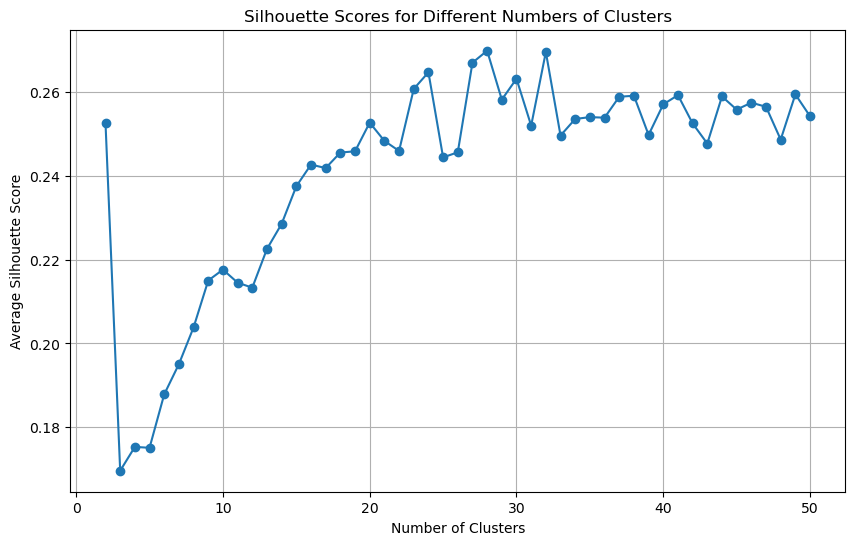

The optimal number of clusters is 28 with a silhouette score of 0.2697.


In [ ]:
clusters, scores = zip(*silhouette_avgs)
plt.figure(figsize=(10, 6))
plt.plot(clusters, scores, marker='o')
plt.title("Silhouette Scores for Different Numbers of Clusters")
plt.xlabel("Number of Clusters")
plt.ylabel("Average Silhouette Score")
plt.grid(True)
plt.show()

# Find and print the optimal number of clusters
optimal_clusters = clusters[np.argmax(scores)]
print(f"The optimal number of clusters is {optimal_clusters} with a silhouette score of {max(scores):.4f}.")

In [ ]:
optimal_kmeans = KMeans(n_clusters=optimal_clusters, random_state=32)
optimal_cluster_labels = optimal_kmeans.fit_predict(train_embeddings)

c:\Users\sagar\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\Users\sagar\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(


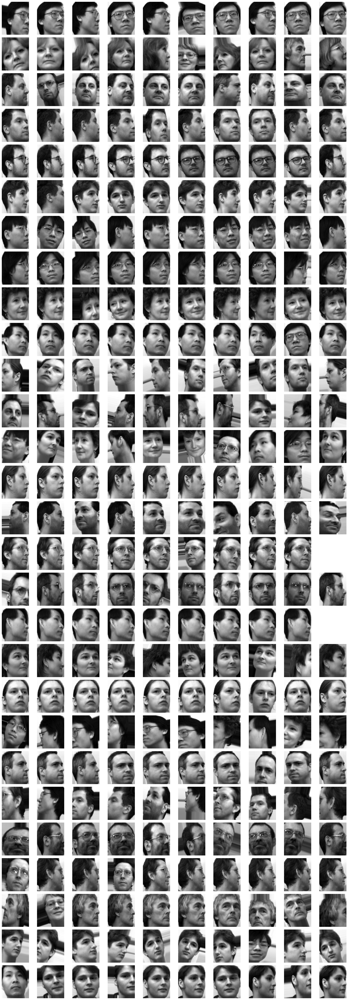

In [ ]:
def group_images_by_cluster(images, cluster_labels):
    clusters = {}
    for idx, cluster in enumerate(cluster_labels):
        if cluster not in clusters:
            clusters[cluster] = []
        # Ensure images have the correct shape for visualization
        clusters[cluster].append(images[idx].squeeze())  
    return clusters

# Group images by cluster
clusters = group_images_by_cluster(X_train, optimal_cluster_labels)

def plot_clusters(clusters, images_per_cluster=10):
    num_clusters = len(clusters)
    
    # Create a figure with a grid of subplots
    fig, axes = plt.subplots(num_clusters, images_per_cluster, 
                             figsize=(images_per_cluster * 2, num_clusters * 2))
    if num_clusters == 1:  # Special handling for a single cluster
        axes = np.expand_dims(axes, axis=0)

    for cluster_id, image_list in clusters.items():
        for i in range(min(len(image_list), images_per_cluster)):
            ax = axes[cluster_id, i]
            ax.imshow(image_list[i], cmap='gray')
            ax.axis('off')
        # Turn off extra axes in the row
        for j in range(len(image_list), images_per_cluster):
            ax = axes[cluster_id, j]
            ax.axis('off')
    plt.tight_layout()
    plt.show()

# Plot the clusters
plot_clusters(clusters, images_per_cluster=10)


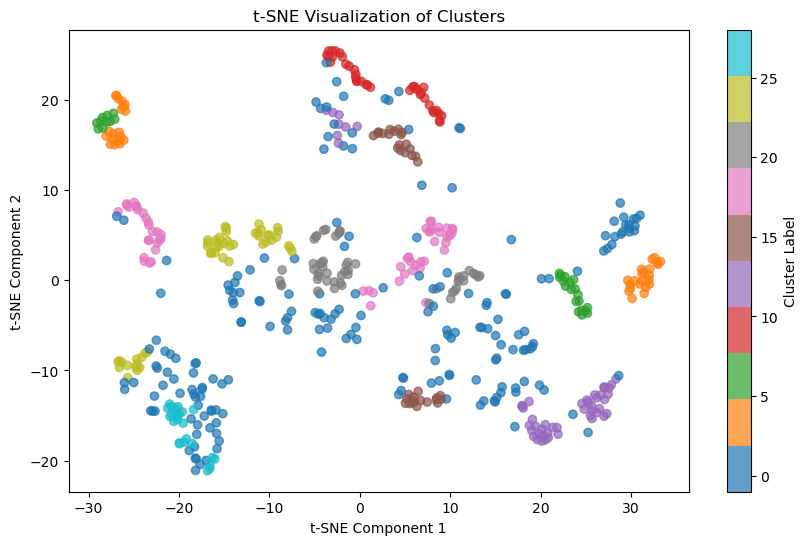

In [ ]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, random_state=32)
tsne_embeddings = tsne.fit_transform(train_embeddings)

plt.figure(figsize=(10, 6))
scatter = plt.scatter(
    tsne_embeddings[:, 0],
    tsne_embeddings[:, 1],
    c=cluster_labels,
    cmap="tab10",
    alpha=0.7,
)
plt.colorbar(scatter, label="Cluster Label")
plt.title("t-SNE Visualization of Clusters")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.show()


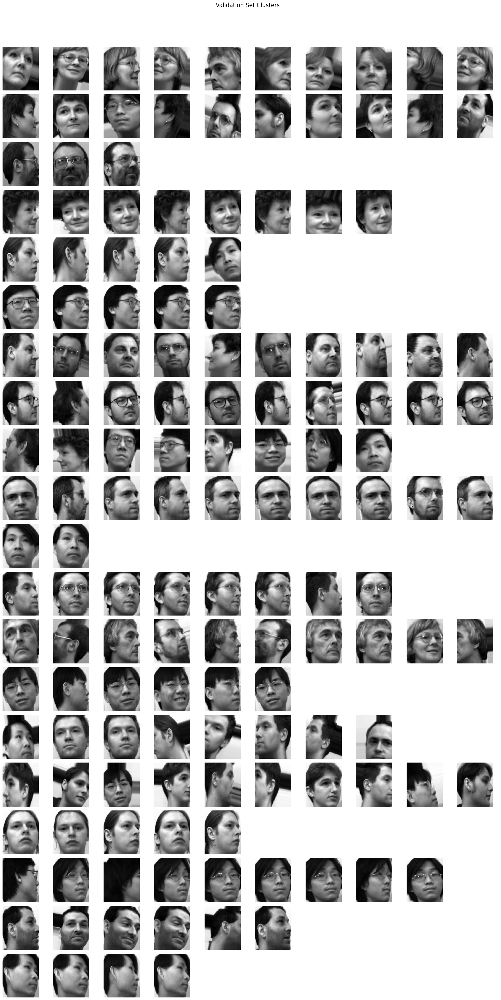

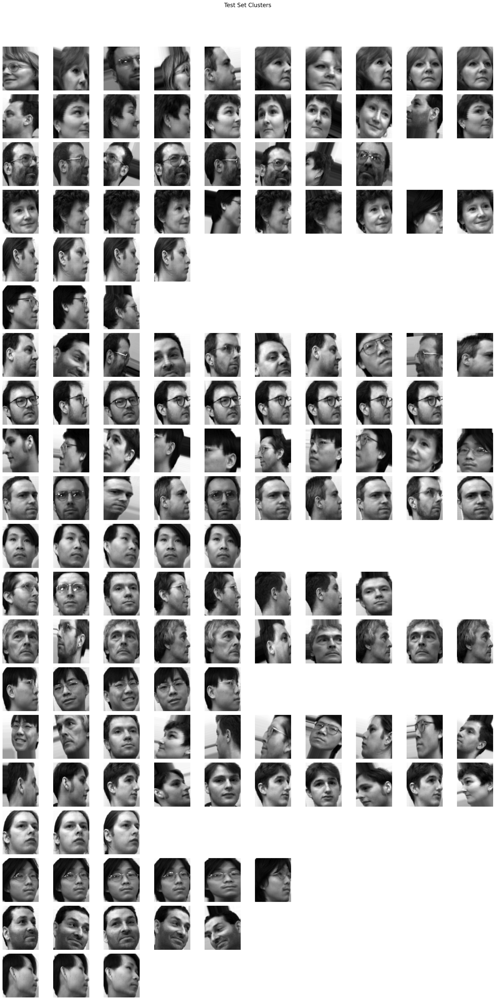

In [ ]:
# Group images by cluster
def group_images_by_cluster(images, cluster_labels):
    clusters = {}
    for idx, cluster in enumerate(cluster_labels):
        if cluster not in clusters:
            clusters[cluster] = []
        clusters[cluster].append(images[idx])
    return clusters

def plot_clusters_with_title(clusters, images_per_cluster=10, title="Cluster Visualization"):
    num_clusters = len(clusters)
    fig, axes = plt.subplots(num_clusters, images_per_cluster, figsize=(images_per_cluster * 2, num_clusters * 2))
    for cluster_id, image_list in clusters.items():
        for i in range(min(len(image_list), images_per_cluster)):
            ax = axes[cluster_id, i] if num_clusters > 1 else axes[i]
            ax.imshow(image_list[i].squeeze(), cmap='gray')
            ax.axis('off')
        for j in range(len(image_list), images_per_cluster):
            ax = axes[cluster_id, j] if num_clusters > 1 else axes[j]
            ax.axis('off')
    plt.suptitle(title, fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

val_cluster_labels = kmeans.predict(val_embeddings) 
test_cluster_labels = kmeans.predict(test_embeddings) 

val_clusters = group_images_by_cluster(val_images, val_cluster_labels)  
test_clusters = group_images_by_cluster(test_images, test_cluster_labels)  

plot_clusters_with_title(val_clusters, images_per_cluster=10, title="Validation Set Clusters")
plot_clusters_with_title(test_clusters, images_per_cluster=10, title="Test Set Clusters")


In [ ]:
y_train_kmeans = kmeans.predict(train_embeddings)
y_val_kmeans = kmeans.predict(val_embeddings)
y_test_kmeans = kmeans.predict(test_embeddings)

from tensorflow.keras.utils import to_categorical

# Number of clusters from KMeans
num_clusters = len(np.unique(y_train_kmeans))

# One-hot encode the cluster labels
y_train_kmeans_one_hot = to_categorical(y_train_kmeans, num_clusters)
y_val_kmeans_one_hot = to_categorical(y_val_kmeans, num_clusters)
y_test_kmeans_one_hot = to_categorical(y_test_kmeans, num_clusters)

print(f"One-Hot Encoded KMeans Labels Shape (Train): {y_train_kmeans_one_hot.shape}")

# Expand dimensions of cluster labels to match feature shapes
y_train_kmeans_expanded = y_train_kmeans[:, np.newaxis]
y_val_kmeans_expanded = y_val_kmeans[:, np.newaxis]
y_test_kmeans_expanded = y_test_kmeans[:, np.newaxis]

# Combine embeddings with cluster labels as features
train_combined_features = np.hstack((train_embeddings, y_train_kmeans_one_hot))
val_combined_features = np.hstack((val_embeddings, y_val_kmeans_one_hot))
test_combined_features = np.hstack((test_embeddings, y_test_kmeans_one_hot))

print(f"Train Combined Features Shape: {train_combined_features.shape}")
print(f"Validation Combined Features Shape: {val_combined_features.shape}")
print(f"Test Combined Features Shape: {test_combined_features.shape}")

from sklearn.preprocessing import LabelEncoder

# Initialize LabelEncoder
label_encoder = LabelEncoder()

# Encode the labels
y_train = label_encoder.fit_transform(y_train)
y_val = label_encoder.transform(y_val)
y_test = label_encoder.transform(y_test)


One-Hot Encoded KMeans Labels Shape (Train): (576, 20)
Train Combined Features Shape: (576, 276)
Validation Combined Features Shape: (192, 276)
Test Combined Features Shape: (192, 276)


In [ ]:
from tensorflow.keras import layers, models

def build_nn(input_dim, num_classes):
    model = models.Sequential([
        layers.Input(shape=(input_dim,)),
        layers.Dense(256, activation='relu'),
        layers.Dropout(0.4),
        layers.Dense(128, activation='relu'),
        layers.BatchNormalization(),
        layers.Dropout(0.4),
        layers.Dense(num_classes, activation='softmax')
    ])
    return model

# Input dimensions
input_dim = train_combined_features.shape[1]
num_classes = len(np.unique(y_train))  # Replace with your actual target labels if different

# Build the model
nn_model = build_nn(input_dim, num_classes)
nn_model.summary()


from tensorflow.keras.optimizers import Adam

# Compile the model
nn_model.compile(optimizer=Adam(learning_rate=0.001),
                 loss='sparse_categorical_crossentropy',
                 metrics=['accuracy'])

# Train the model
history = nn_model.fit(
    train_combined_features, y_train,  # Assuming y_train contains the actual class labels
    validation_data=(val_combined_features, y_val),
    epochs=25,
    batch_size=32
)

# Evaluate on the test set
test_loss, test_accuracy = nn_model.evaluate(test_combined_features, y_test, verbose=2)
print(f"Test Accuracy: {test_accuracy:.4f}")


Model: "sequential_26"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_46 (Dense)                │ (None, 256)            │        70,912 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_13 (Dropout)            │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_47 (Dense)                │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_14 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_48 (Dense)                │ (None, 20)             │         2,580 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 106,900 (417.58 KB)

 Trainable params: 106,644 (416.58 KB)

 Non-trainable params: 256 (1.00 KB)

Epoch 1/25
18/18 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step - accuracy: 0.0730 - loss: 3.8555 - val_accuracy: 0.1302 - val_loss: 4.0375
Epoch 2/25
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.1877 - loss: 2.8044 - val_accuracy: 0.3385 - val_loss: 2.3165
Epoch 3/25
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.3490 - loss: 2.1252 - val_accuracy: 0.4635 - val_loss: 1.5992
Epoch 4/25
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.4507 - loss: 1.6275 - val_accuracy: 0.5938 - val_loss: 1.2420
Epoch 5/25
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6412 - loss: 1.1729 - val_accuracy: 0.7135 - val_loss: 1.0022
Epoch 6/25
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.7047 - loss: 0.9479 - val_accuracy: 0.7135 - val_loss: 0.9277
Epoch 7/25
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.7557 - loss: 0.7282 - val_accuracy: 0.7656 - val_loss: 0.9042
Epoch 8/25
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.8168 - loss: 0.6122 - val_accuracy: 0.7604 - val_los

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


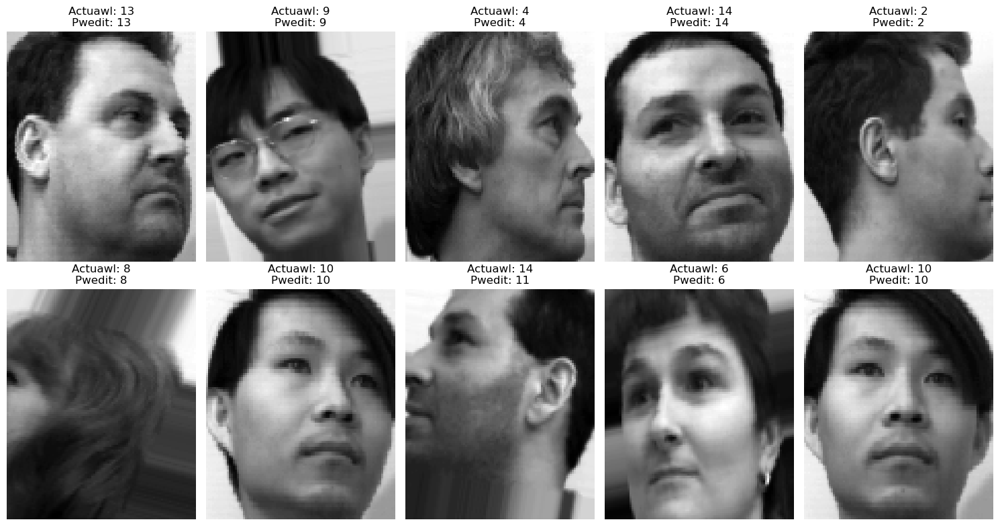

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# How many pictuwes yoo wanna see, bawby?
num_samples = 10  # Change dis numbew to see mowe or wess
random_indices = np.random.choice(len(X_test), num_samples, replace=False)

# Pwint each pictuwe wif its pwediction
plt.figure(figsize=(15, 8))
for i, index in enumerate(random_indices):
    # Pwepawe da singwe sampwe fow pwediction
    single_sample = np.expand_dims(test_combined_features[index], axis=0)
    predicted = nn_model.predict(single_sample)
    predicted_class = np.argmax(predicted)
    actual = y_test[index]

    # Pwot da pictuwe
    plt.subplot(2, (num_samples + 1) // 2, i + 1)  # 2 wows
    plt.imshow(X_test[index].squeeze(), cmap='gray')  # Fow gwayscawe
    plt.title(f"Actuawl: {actual}\nPwedit: {predicted_class}")
    plt.axis('off')

plt.tight_layout()
plt.show()


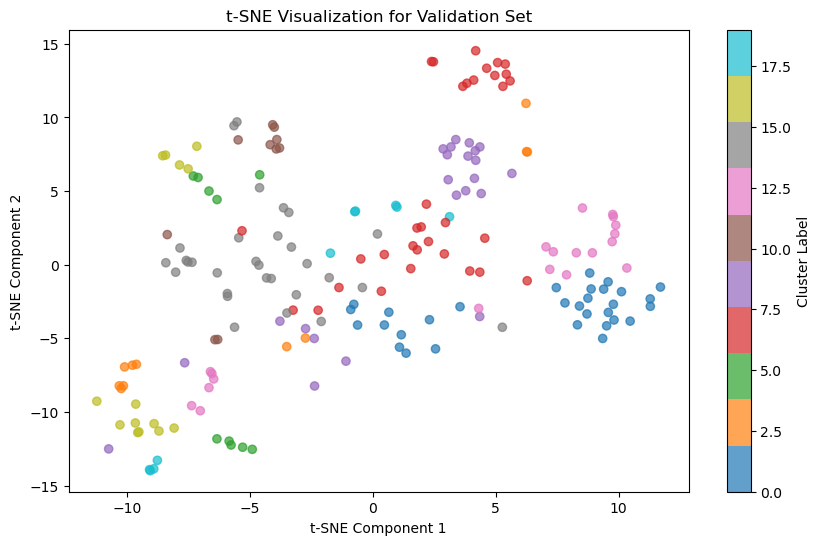

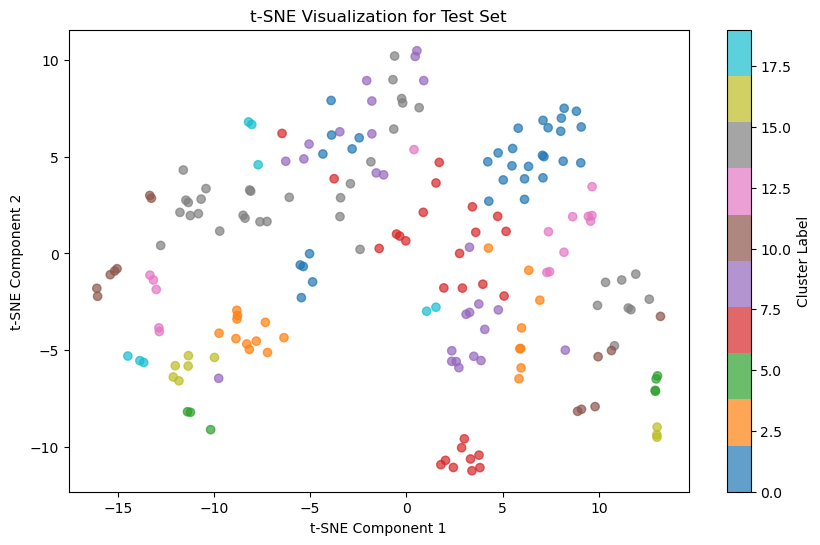

In [ ]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

def plot_tsne(embeddings, labels, title="t-SNE Visualization"):
    tsne = TSNE(n_components=2, random_state=32, perplexity=30)
    tsne_results = tsne.fit_transform(embeddings)
    
    plt.figure(figsize=(10, 6))
    scatter = plt.scatter(
        tsne_results[:, 0], tsne_results[:, 1], c=labels, cmap="tab10", alpha=0.7
    )
    plt.colorbar(scatter, label="Cluster Label")
    plt.title(title)
    plt.xlabel("t-SNE Component 1")
    plt.ylabel("t-SNE Component 2")
    plt.show()

val_labels = kmeans.predict(val_embeddings)
test_labels = kmeans.predict(test_embeddings)

plot_tsne(val_embeddings, val_labels, title="t-SNE Visualization for Validation Set")
plot_tsne(test_embeddings, test_labels, title="t-SNE Visualization for Test Set")


##DBSCAN USING CNN

In [ ]:
import hdbscan
min_cluster_sizes = [5, 10, 20, 50, 100]
min_samples_values = [2, 5, 10, 15]

results = []

# Grid search for optimal parameters
for min_cluster_size in min_cluster_sizes:
    for min_samples in min_samples_values:
        # Perform HDBSCAN clustering
        clusterer_hdb = hdbscan.HDBSCAN(
            min_cluster_size=min_cluster_size, 
            min_samples=min_samples,
            prediction_data=True
        )
        cluster_labels_hdb = clusterer_hdb.fit_predict(train_embeddings)
        
        # Count unique clusters (excluding noise points)
        unique_clusters_hdb = np.unique(cluster_labels_hdb[cluster_labels_hdb != -1])
        n_clusters_hdb = len(unique_clusters_hdb)

        if n_clusters_hdb < 2:
            continue
        
        # Calculate clustering metrics
        try:
            from sklearn.metrics import silhouette_score
            
            # Mask out noise points
            mask = cluster_labels_hdb != -1
            if np.sum(mask) > 1:
                sil_score = silhouette_score(train_embeddings[mask], cluster_labels_hdb[mask])
            else:
                continue
            
            results.append({
                'min_cluster_size': min_cluster_size,
                'min_samples': min_samples,
                'n_clusters': n_clusters_hdb,
                'silhouette_score': sil_score,
                'noise_ratio': np.mean(cluster_labels_hdb == -1)
            })
        except Exception as e:
            print(f"Error with min_cluster_size={min_cluster_size}, min_samples={min_samples}: {e}")


In [ ]:
results_df = pd.DataFrame(results)

# Sort results
results_sorted = results_df.sort_values(['n_clusters', 'silhouette_score'], ascending=[False, False])

# Display top results
print("Top HDBSCAN Parameter Combinations:")
print(results_sorted.head())

# Select best parameters
best_params = results_sorted.iloc[0]
print("\nBest Parameters:")
print(f"Min Cluster Size: {best_params['min_cluster_size']}")
print(f"Min Samples: {best_params['min_samples']}")
print(f"Number of Clusters: {best_params['n_clusters']}")
print(f"Silhouette Score: {best_params['silhouette_score']:.4f}")
print(f"Noise Ratio: {best_params['noise_ratio']:.2%}")

Top HDBSCAN Parameter Combinations:
   min_cluster_size  min_samples  n_clusters  silhouette_score  noise_ratio
0                 5            2          29          0.382705     0.309028
1                 5            5          22          0.398477     0.336806
4                10            2          20          0.342326     0.246528
5                10            5          18          0.380898     0.335069
2                 5           10          16          0.446383     0.500000

Best Parameters:
Min Cluster Size: 5.0
Min Samples: 2.0
Number of Clusters: 29.0
Silhouette Score: 0.3827
Noise Ratio: 30.90%


In [ ]:
final_clusterer = hdbscan.HDBSCAN(
    min_cluster_size=int(best_params['min_cluster_size']), 
    min_samples=int(best_params['min_samples']),
    prediction_data=True
)
cluster_labels_hdb = final_clusterer.fit_predict(train_embeddings)

(576,)

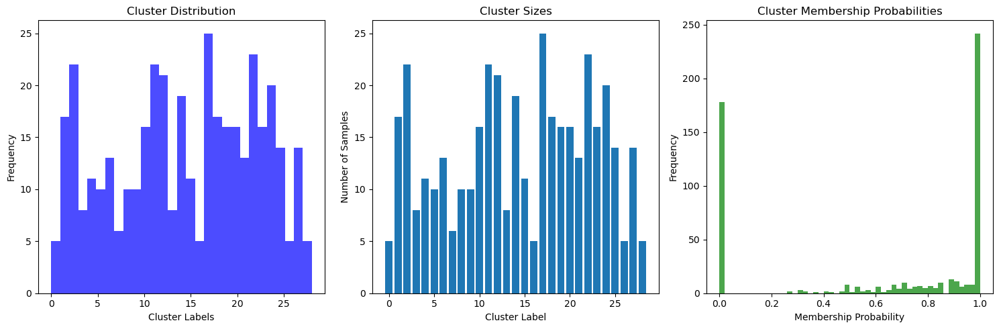


Cluster Details:
Cluster -1: 178 samples
Cluster 0: 5 samples
Cluster 1: 17 samples
Cluster 2: 22 samples
Cluster 3: 8 samples
Cluster 4: 11 samples
Cluster 5: 10 samples
Cluster 6: 13 samples
Cluster 7: 6 samples
Cluster 8: 10 samples
Cluster 9: 10 samples
Cluster 10: 16 samples
Cluster 11: 22 samples
Cluster 12: 21 samples
Cluster 13: 8 samples
Cluster 14: 19 samples
Cluster 15: 11 samples
Cluster 16: 5 samples
Cluster 17: 25 samples
Cluster 18: 17 samples
Cluster 19: 16 samples
Cluster 20: 16 samples
Cluster 21: 13 samples
Cluster 22: 23 samples
Cluster 23: 16 samples
Cluster 24: 20 samples
Cluster 25: 14 samples
Cluster 26: 5 samples
Cluster 27: 14 samples
Cluster 28: 5 samples


In [ ]:
plt.figure(figsize=(15,5))

# Cluster Distribution
plt.subplot(131)
plt.title('Cluster Distribution')
unique_clusters = cluster_labels_hdb[cluster_labels_hdb != -1]
plt.hist(unique_clusters, bins=len(np.unique(unique_clusters)), color='blue', alpha=0.7)
plt.xlabel('Cluster Labels')
plt.ylabel('Frequency')

# Cluster Sizes
plt.subplot(132)
cluster_sizes = np.unique(unique_clusters, return_counts=True)
plt.bar(cluster_sizes[0], cluster_sizes[1])
plt.title('Cluster Sizes')
plt.xlabel('Cluster Label')
plt.ylabel('Number of Samples')

# Cluster Membership Probabilities
plt.subplot(133)
plt.title('Cluster Membership Probabilities')
plt.hist(final_clusterer.probabilities_, bins=50, color='green', alpha=0.7)
plt.xlabel('Membership Probability')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

# Detailed cluster information
print("\nCluster Details:")
unique_labels, counts = np.unique(cluster_labels_hdb, return_counts=True)
for label, count in zip(unique_labels, counts):
    print(f"Cluster {label}: {count} samples")

In [ ]:
def group_images_by_cluster_hdb(images, cluster_labels):
    clusters = {}
    
    # Iterate through images and their cluster labels
    for idx, cluster in enumerate(cluster_labels):
        # Create cluster key if not exists, including noise cluster
        if cluster not in clusters:
            clusters[cluster] = []
        
        # Ensure images have the correct shape for visualization
        clusters[cluster].append(images[idx].squeeze())
    
    return clusters

def plot_clusters_hdb(clusters, images_per_cluster=10, cmap='gray'):
    # Separate noise cluster if present
    noise_cluster = clusters.get(-1, [])
    
    # Remove noise cluster for main plotting
    clusters_to_plot = {k: v for k, v in clusters.items() if k != -1}
    
    # Calculate number of clusters
    num_clusters = len(clusters_to_plot)
    
    # Adjust plot if noise cluster exists
    has_noise = len(noise_cluster) > 0
    
    # Create figure with appropriate subplot configuration
    if has_noise:
        fig, axes = plt.subplots(num_clusters + 1, images_per_cluster, 
                                  figsize=((images_per_cluster * 2), ((num_clusters + 1) * 2)))
        noise_axes = axes[-1, :]
    else:
        fig, axes = plt.subplots(num_clusters, images_per_cluster, 
                                  figsize=((images_per_cluster * 2), (num_clusters * 2)))
        noise_axes = None
    
    # Ensure axes is always a 2D array
    if num_clusters == 1:
        axes = np.expand_dims(axes, axis=0)
    
    # Plot cluster images
    for cluster_id, image_list in clusters_to_plot.items():
        for i in range(min(len(image_list), images_per_cluster)):
            ax = axes[cluster_id, i]
            ax.imshow(image_list[i], cmap=cmap)
            ax.axis('off')
            ax.set_title(f'Cluster {cluster_id}')
        
        # Turn off extra axes in the row
        for j in range(len(image_list), images_per_cluster):
            ax = axes[cluster_id, j]
            ax.axis('off')
    
    # Plot noise points if they exist
    if has_noise:
        for i in range(min(len(noise_cluster), images_per_cluster)):
            noise_axes[i].imshow(noise_cluster[i], cmap=cmap)
            noise_axes[i].axis('off')
            noise_axes[i].set_title('Noise')
        
        # Turn off extra noise axes
        for j in range(len(noise_cluster), images_per_cluster):
            noise_axes[j].axis('off')
    
    plt.tight_layout()
    plt.show()


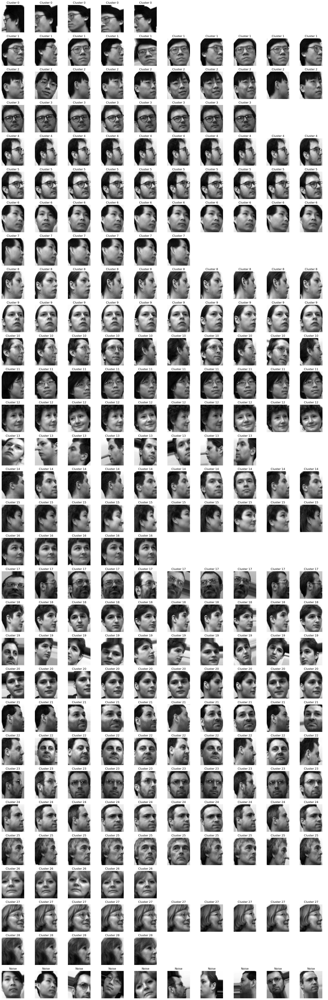

In [ ]:
clusters_hdb = group_images_by_cluster_hdb(X_train, cluster_labels_hdb)
plot_clusters_hdb(clusters_hdb, images_per_cluster=10)

In [ ]:
unique_clusters_hdb = np.unique(cluster_labels_hdb[cluster_labels_hdb != -1])
print(f"Number of clusters (excluding noise): {len(unique_clusters_hdb)}")

# Replace noise (-1) with a separate cluster ID
cluster_labels_hdb = np.where(cluster_labels_hdb == -1, len(unique_clusters_hdb), cluster_labels_hdb)


Number of clusters (excluding noise): 29


In [ ]:
# One-hot encode HDBSCAN cluster labels
train_hdb_labels_one_hot = to_categorical(cluster_labels_hdb, num_classes=len(np.unique(cluster_labels_hdb)))

# Predict validation and test labels using HDBSCAN
import hdbscan.prediction

val_hdb_labels, _ = hdbscan.prediction.approximate_predict(final_clusterer, val_embeddings)
val_hdb_labels = np.where(val_hdb_labels == -1, len(unique_clusters_hdb), val_hdb_labels)
val_hdb_labels_one_hot = to_categorical(val_hdb_labels, num_classes=len(np.unique(cluster_labels_hdb)))

test_hdb_labels, _ = hdbscan.prediction.approximate_predict(final_clusterer, test_embeddings)
test_hdb_labels = np.where(test_hdb_labels == -1, len(unique_clusters_hdb), test_hdb_labels)
test_hdb_labels_one_hot = to_categorical(test_hdb_labels, num_classes=len(np.unique(cluster_labels_hdb)))

# Combine embeddings with HDBSCAN one-hot encoded labels
train_combined_features_hdb = np.hstack((train_embeddings, train_hdb_labels_one_hot))
val_combined_features_hdb = np.hstack((val_embeddings, val_hdb_labels_one_hot))
test_combined_features_hdb = np.hstack((test_embeddings, test_hdb_labels_one_hot))


In [ ]:
input_dim_hdb = train_combined_features_hdb.shape[1]
num_classes_hdb = len(np.unique(cluster_labels_hdb))

nn_model = build_nn(input_dim=input_dim_hdb, num_classes=num_classes_hdb)
nn_model.compile(optimizer=Adam(learning_rate=0.001),
                 loss='sparse_categorical_crossentropy',
                 metrics=['accuracy'])

history_hdb = nn_model.fit(
    train_combined_features_hdb, cluster_labels_hdb,
    validation_data=(val_combined_features_hdb, val_hdb_labels),
    epochs=25,
    batch_size=32
)



Epoch 1/25
18/18 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step - accuracy: 0.0550 - loss: 4.4432 - val_accuracy: 0.1042 - val_loss: 5.2415
Epoch 2/25
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.1478 - loss: 3.3551 - val_accuracy: 0.2135 - val_loss: 3.8434
Epoch 3/25
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.3247 - loss: 2.7496 - val_accuracy: 0.3698 - val_loss: 2.7256
Epoch 4/25
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.3669 - loss: 2.2705 - val_accuracy: 0.6458 - val_loss: 1.9006
Epoch 5/25
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.4797 - loss: 1.8559 - val_accuracy: 0.7396 - val_loss: 1.3803
Epoch 6/25
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.6040 - loss: 1.4365 - val_accuracy: 0.8490 - val_loss: 0.7252
Epoch 7/25
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.6492 - loss: 1.2724 - val_accuracy: 0.8698 - val_loss: 0.5459
Epoch 8/25
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.6676 - loss: 1.1274 - val_accuracy: 0.8854 - val_los

In [ ]:
results = nn_model.evaluate(test_combined_features_hdb, test_hdb_labels, verbose=2)

In [ ]:
print(f"Train embeddings shape: {train_embeddings.shape}")
print(f"One-hot encoded train labels shape: {train_hdb_labels_one_hot.shape}")
print(f"Combined train features shape: {train_combined_features_hdb.shape}")


Train embeddings shape: (576, 256)
One-hot encoded train labels shape: (576, 30)
Combined train features shape: (576, 286)


6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


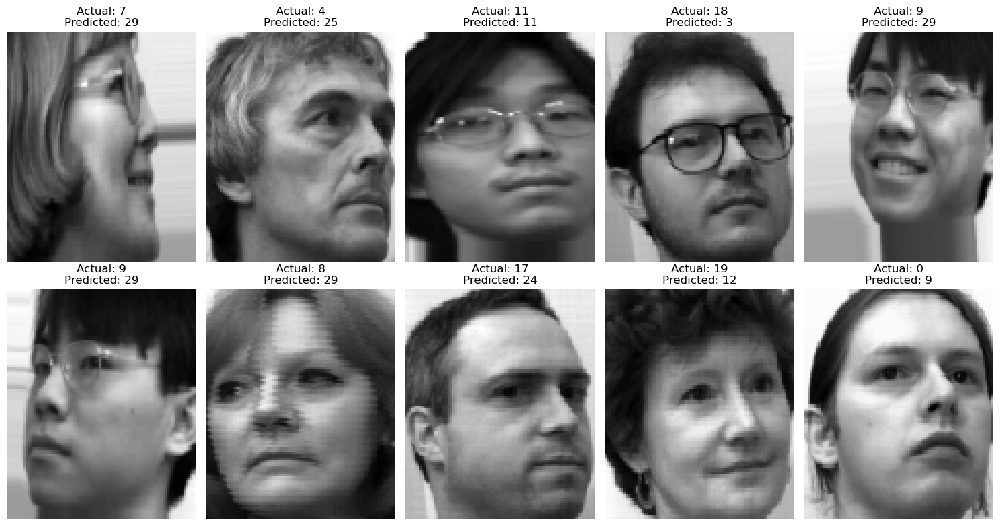

In [ ]:
test_predictions = nn_model.predict(test_combined_features_hdb)
predicted_labels = np.argmax(test_predictions, axis=1)

num_images = 10  # Adjust the number of images to display
random_indices = np.random.choice(len(X_test), num_images, replace=False)

# Plot the images with actual and predicted labels
plt.figure(figsize=(15, 8))
for i, idx in enumerate(random_indices):
    plt.subplot(2, (num_images + 1) // 2, i + 1)  # 2 rows
    plt.imshow(X_test[idx].squeeze(), cmap='gray')  # Adjust for grayscale or RGB images
    actual_label = y_test[idx]  # Replace `y_test` with your actual labels if different
    predicted_label = predicted_labels[idx]
    plt.title(f"Actual: {actual_label}\nPredicted: {predicted_label}")
    plt.axis('off')

plt.tight_layout()
plt.show()

In [ ]:
import numpy as np
from collections import Counter

# Map clusters to labels based on majority voting
def map_clusters_to_labels(cluster_labels, true_labels):
    mapping = {}
    unique_clusters = np.unique(cluster_labels)

    for cluster in unique_clusters:
        if cluster == -1:  # Skip noise points
            continue
        # Get the indices of the points in the current cluster
        indices = np.where(cluster_labels == cluster)[0]
        # Get the true labels for those points
        true_labels_in_cluster = true_labels[indices]
        # Find the most common label (majority label)
        most_common_label = Counter(true_labels_in_cluster).most_common(1)[0][0]
        mapping[cluster] = most_common_label

    return mapping

cluster_to_label_mapping = map_clusters_to_labels(cluster_labels_hdb, y_train)

def map_predictions(cluster_labels, mapping):
    return np.array([mapping.get(cluster, -1) for cluster in cluster_labels])

mapped_test_labels = map_predictions(test_hdb_labels, cluster_to_label_mapping)


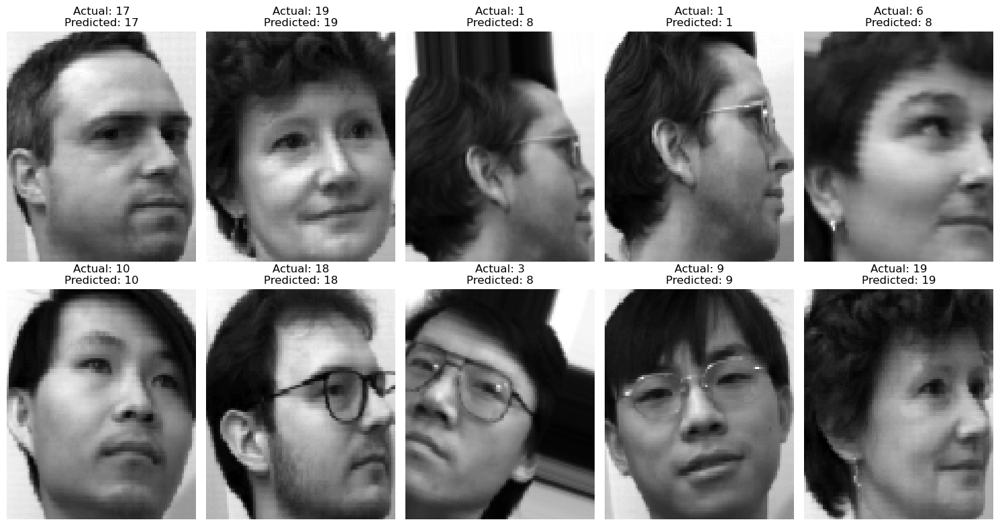

In [ ]:
num_images = 10
random_indices = np.random.choice(len(X_test), num_images, replace=False)

plt.figure(figsize=(15, 8))
for i, idx in enumerate(random_indices):
    plt.subplot(2, (num_images + 1) // 2, i + 1)
    plt.imshow(X_test[idx].squeeze(), cmap='gray')
    actual_label = y_test[idx]
    predicted_label = mapped_test_labels[idx]
    plt.title(f"Actual: {actual_label}\nPredicted: {predicted_label}")
    plt.axis('off')

plt.tight_layout()
plt.show()
